In [1]:
import os
import matplotlib.pyplot as plt
from IPython.display import Image
import torch
import torch.nn as nn
from torch.optim.lr_scheduler import StepLR
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from torchvision.utils import save_image

In [2]:
data_dir = '../dataset/face_imgs'

transform = transforms.Compose([
    transforms.RandomResizedCrop(size=(256, 256), scale=(0.9, 1.0), ratio=(0.9, 1.1)),
    transforms.ToTensor(),
    transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
])
dataset = datasets.ImageFolder(root=data_dir, transform=transform)

batch_size = 10
data_loader = DataLoader(dataset, batch_size, shuffle=True, num_workers=4)


def denorm(x):
    out = (x * 0.5) + 0.5
    return out.clamp(0, 1)

In [3]:
img, label = dataset[0]
print('Label: ', label)
print(img[:, 10:15, 10:15])
torch.min(img), torch.max(img)

Label:  0
tensor([[[-0.8588, -0.8588, -0.8588, -0.8510, -0.8510],
         [-0.8510, -0.8588, -0.8588, -0.8510, -0.8510],
         [-0.8588, -0.8588, -0.8588, -0.8510, -0.8510],
         [-0.8588, -0.8588, -0.8510, -0.8588, -0.8588],
         [-0.8588, -0.8588, -0.8510, -0.8588, -0.8510]],

        [[-0.8431, -0.8510, -0.8588, -0.8510, -0.8510],
         [-0.8353, -0.8510, -0.8588, -0.8510, -0.8510],
         [-0.8431, -0.8431, -0.8588, -0.8510, -0.8510],
         [-0.8431, -0.8431, -0.8510, -0.8588, -0.8588],
         [-0.8431, -0.8510, -0.8431, -0.8510, -0.8510]],

        [[-0.8510, -0.8588, -0.8588, -0.8510, -0.8510],
         [-0.8431, -0.8510, -0.8588, -0.8510, -0.8510],
         [-0.8510, -0.8510, -0.8588, -0.8510, -0.8510],
         [-0.8510, -0.8510, -0.8510, -0.8588, -0.8588],
         [-0.8510, -0.8510, -0.8510, -0.8510, -0.8510]]])


(tensor(-0.9843), tensor(0.5686))

Label:  0


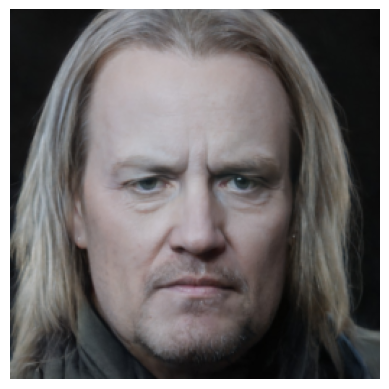

In [4]:
%matplotlib inline

img_norm = denorm(img)
img_show = img_norm.permute(1, 2, 0).numpy()
print('Label: ', label)
plt.imshow(img_show)
plt.axis('off')
plt.show()

first batch
torch.Size([10, 3, 256, 256])
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0])


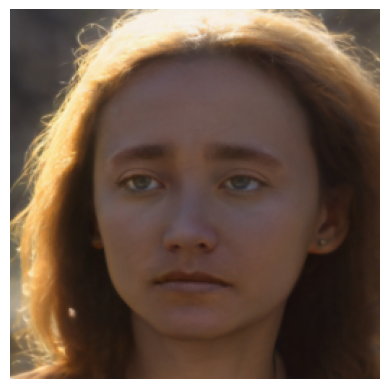

In [5]:
for img_batch, label_batch in data_loader:
    print('first batch')
    print(img_batch.shape)
    img_norm = denorm(img_batch[0])
    img_show = img_norm.permute(1, 2, 0).numpy()
    print(label_batch)
    plt.imshow(img_show)
    plt.axis('off')
    plt.show()
    break

In [6]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [7]:
# class Discriminator(nn.Module):
#     def __init__(self):
#         super(Discriminator, self).__init__()
#         self.model = nn.Sequential(
#             nn.Conv2d(3, 16, 4, 2, 1, bias=False),
#             nn.LeakyReLU(0.2, inplace=True),
#             nn.Conv2d(16, 32, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(32),
#             nn.LeakyReLU(0.2, inplace=True),
#             nn.Conv2d(32, 64, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(64),
#             nn.LeakyReLU(0.2, inplace=True),
#             nn.Conv2d(64, 128, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(128),
#             nn.LeakyReLU(0.25, inplace=True),
#             nn.Conv2d(128, 256, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(256),
#             nn.LeakyReLU(0.25, inplace=True),
#             nn.Conv2d(256, 512, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(512),
#             nn.LeakyReLU(0.25, inplace=True),
#             nn.Conv2d(512, 1, 4, 1, 0, bias=False),
#             nn.Sigmoid()
#         )
# 
#     def forward(self, x):
#         return self.model(x).view(-1, 1).squeeze(1)

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(3, 16, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(16, 32, 4, 2, 1, bias=False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(32, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.25, inplace=True),  # 增加LeakyReLU的负斜率
            nn.Conv2d(128, 192, 4, 2, 1, bias=False),  # 减少过滤器数量
            nn.BatchNorm2d(192),
            nn.LeakyReLU(0.3, inplace=True),  # 增加LeakyReLU的负斜率
            nn.Conv2d(192, 384, 4, 2, 1, bias=False),  # 减少过滤器数量
            nn.BatchNorm2d(384),
            nn.LeakyReLU(0.3, inplace=True),  # 增加LeakyReLU的负斜率
            nn.Conv2d(384, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x).view(-1, 1).squeeze(1)


class Generator(nn.Module):
    def __init__(self, latent_size):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(latent_size, 512, 4, 1, 0, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),
            nn.ConvTranspose2d(64, 32, 4, 2, 1, bias=False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2, inplace=True),
            nn.ConvTranspose2d(32, 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2, inplace=True),
            nn.ConvTranspose2d(16, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, z):
        return self.model(z.view(-1, latent_size, 1, 1))

In [8]:
latent_size = 100

G = Generator(latent_size)
D = Discriminator()

In [9]:
y = G(torch.randn(2, latent_size))
gen_imgs = denorm(y.reshape((-1, 256, 256)).detach())

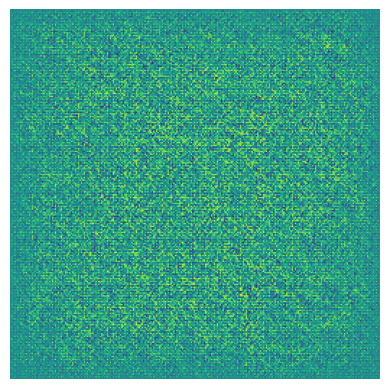

In [10]:
img_show = gen_imgs[0].numpy()
plt.imshow(img_show)
plt.axis('off')
plt.show()

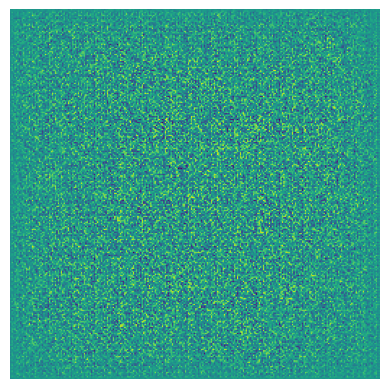

In [11]:
img_show = gen_imgs[1].numpy()
plt.imshow(img_show)
plt.axis('off')
plt.show()

In [12]:
G.to(device)
D.to(device)

Discriminator(
  (model): Sequential(
    (0): Conv2d(3, 16, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(16, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.25, inplace=True)
    (11): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(256, eps=1e-05, mome

In [13]:
criterion = nn.BCELoss()

d_optimizer = torch.optim.Adam(D.parameters(), lr=0.0002, betas=(0.5, 0.999))
g_optimizer = torch.optim.Adam(G.parameters(), lr=0.0002, betas=(0.5, 0.999))

d_scheduler = StepLR(d_optimizer, step_size=100, gamma=0.1)
g_scheduler = StepLR(g_optimizer, step_size=100, gamma=0.08)

In [14]:
def reset_grad():
    d_optimizer.zero_grad()
    g_optimizer.zero_grad()


def train_discriminator(images):
    # Create the labels which are later used as input for the BCE loss
    real_labels = 0.8 * torch.ones(batch_size, 1).to(device)
    fake_labels = torch.zeros(batch_size, 1).to(device)

    real_labels = real_labels.squeeze()
    fake_labels = fake_labels.squeeze()

    # Loss for real images
    outputs = D(images).squeeze()
    d_loss_real = criterion(outputs, real_labels)
    real_score = outputs

    # Loss for fake images
    z = torch.randn(batch_size, latent_size).to(device)
    fake_images = G(z)
    outputs = D(fake_images).squeeze()
    d_loss_fake = criterion(outputs, fake_labels)
    fake_score = outputs

    # Combine losses
    d_loss = d_loss_real + d_loss_fake
    # Reset gradients
    reset_grad()
    # Compute gradients
    d_loss.backward()
    # Adjust the parameters using backprop
    d_optimizer.step()

    return d_loss, real_score, fake_score


def train_generator():
    # Generate fake images and calculate loss
    z = torch.randn(batch_size, latent_size).to(device)
    fake_images = G(z.squeeze())
    labels = torch.ones(batch_size, 1).to(device)
    g_loss = criterion(D(fake_images), labels.squeeze())

    # Backprop and optimize
    reset_grad()
    g_loss.backward()
    g_optimizer.step()
    return g_loss, fake_images

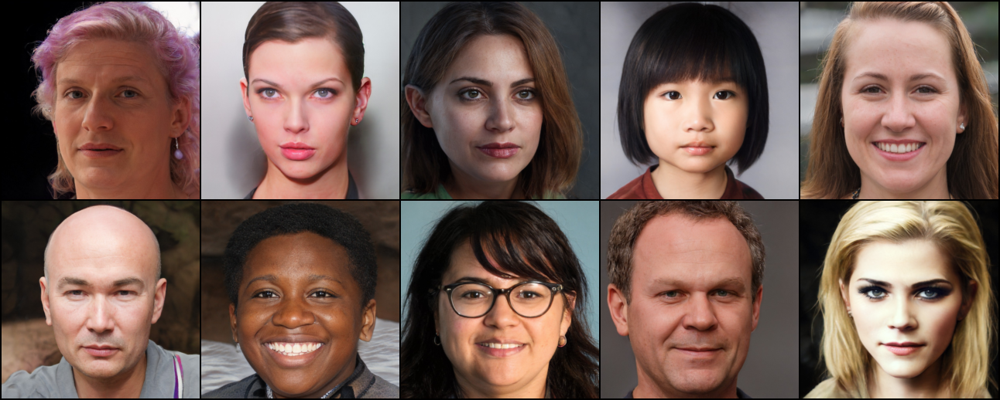

In [15]:
sample_dir = '../DCGAN_2/sample'
if not os.path.exists(sample_dir):
    os.makedirs(sample_dir)

# Save some real images
for images, _ in data_loader:
    images = images.reshape(images.size(0), 3, 256, 256)
    save_image(denorm(images), os.path.join(sample_dir, 'real_images.png'), nrow=5)
    break

Image(os.path.join(sample_dir, 'real_images.png'))

Saving fake_images-0000.png


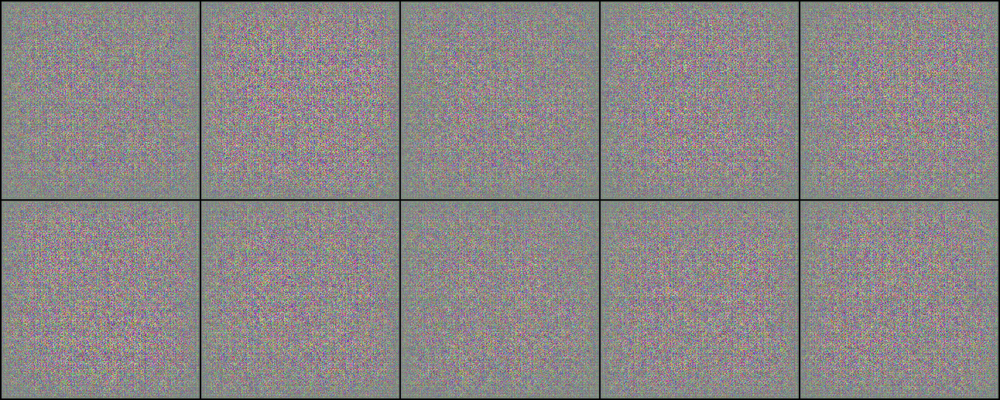

In [16]:
sample_vectors = torch.randn(batch_size, latent_size).to(device)


def save_fake_images(index):
    fake_images = G(sample_vectors)
    fake_images = fake_images.reshape(fake_images.size(0), 3, 256, 256)
    fake_fname = 'fake_images-{0:0=4d}.png'.format(index)
    print('Saving', fake_fname)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=5)


# Before training
save_fake_images(0)
Image(os.path.join(sample_dir, 'fake_images-0000.png'))

In [17]:
num_epochs = 500
g_update_frequency = 1
total_step = len(data_loader)
d_losses, g_losses, real_scores, fake_scores = [], [], [], []
real_score, fake_score, d_loss, g_loss = 0, 0, 0, 0

for epoch in range(num_epochs):
    for i, (images, _) in enumerate(data_loader):
        images = images.to(device)

        # 训练判别器
        noise = torch.randn_like(images) * 0.08
        noisy_images = images + noise
        d_loss, real_score, fake_score = train_discriminator(noisy_images)

        # 多次更新生成器
        for _ in range(g_update_frequency):
            g_loss, fake_images = train_generator()

        # 记录损失和分数
        if (i + 1) % 53 == 0:
            print('Epoch [{}/{}], Step [{}/{}], d_loss: {:.4f}, g_loss: {:.4f}, D(x): {:.2f}, D(G(z)): {:.2f}'
                  .format(epoch, num_epochs, i + 1, total_step, d_loss.item(), g_loss.item(),
                          real_score.mean().item(), fake_score.mean().item()))

    real_scores.append(real_score.mean().item())
    fake_scores.append(fake_score.mean().item())
    d_losses.append(d_loss.item())
    g_losses.append(g_loss.item())

    # 更新调度器
    d_scheduler.step()
    g_scheduler.step()

    # 保存生成的图片
    save_fake_images(epoch + 1)

Epoch [0/500], Step [53/265], d_loss: 0.6202, g_loss: 6.6524, D(x): 0.82, D(G(z)): 0.04
Epoch [0/500], Step [106/265], d_loss: 0.6270, g_loss: 5.7815, D(x): 0.88, D(G(z)): 0.07
Epoch [0/500], Step [159/265], d_loss: 0.5946, g_loss: 6.0327, D(x): 0.81, D(G(z)): 0.03
Epoch [0/500], Step [212/265], d_loss: 0.6060, g_loss: 7.7349, D(x): 0.87, D(G(z)): 0.06
Epoch [0/500], Step [265/265], d_loss: 0.5607, g_loss: 6.6212, D(x): 0.76, D(G(z)): 0.02
Saving fake_images-0001.png
Epoch [1/500], Step [53/265], d_loss: 0.5293, g_loss: 7.4025, D(x): 0.81, D(G(z)): 0.01
Epoch [1/500], Step [106/265], d_loss: 0.5348, g_loss: 6.3915, D(x): 0.73, D(G(z)): 0.00
Epoch [1/500], Step [159/265], d_loss: 0.5187, g_loss: 6.0613, D(x): 0.79, D(G(z)): 0.01
Epoch [1/500], Step [212/265], d_loss: 0.5939, g_loss: 4.8563, D(x): 0.73, D(G(z)): 0.06
Epoch [1/500], Step [265/265], d_loss: 0.5488, g_loss: 6.8300, D(x): 0.80, D(G(z)): 0.04
Saving fake_images-0002.png
Epoch [2/500], Step [53/265], d_loss: 0.5266, g_loss: 6.

In [18]:
torch.save(G.state_dict(), './checkpoints/G.ckpt')
torch.save(D.state_dict(), './checkpoints/D.ckpt')

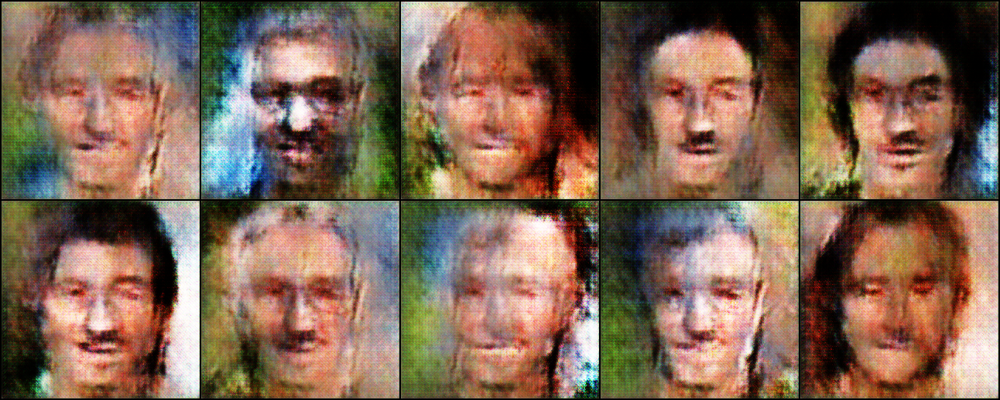

In [19]:
Image('./sample/fake_images-0010.png')

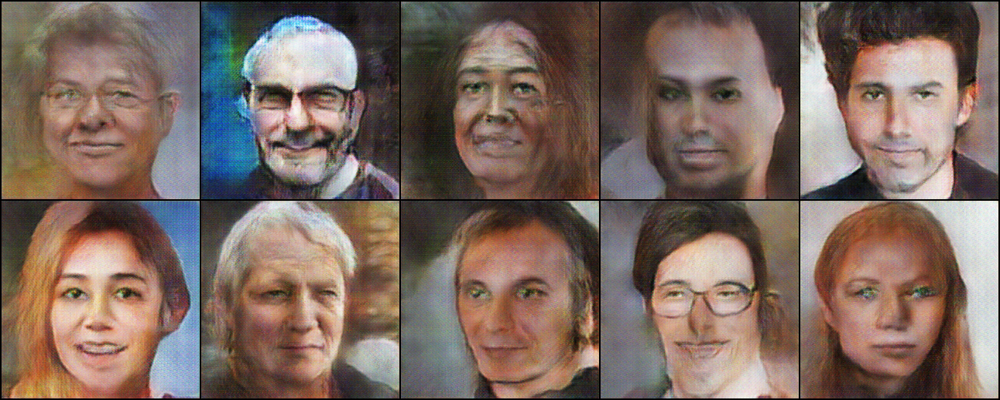

In [20]:
Image('./sample/fake_images-0050.png')

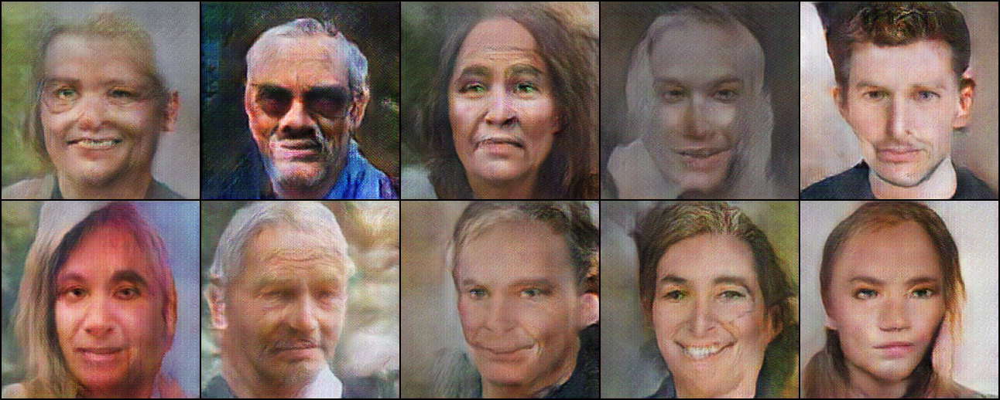

In [21]:
Image('./sample/fake_images-0100.png')

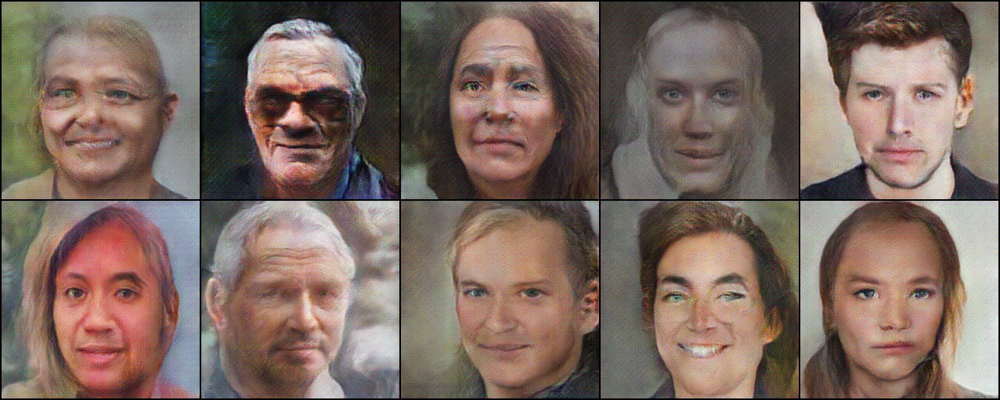

In [22]:
Image('./sample/fake_images-0150.png')

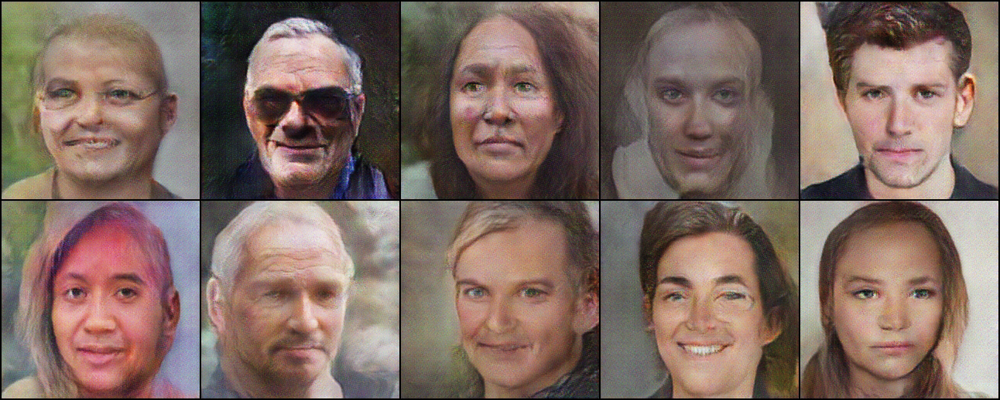

In [23]:
Image('./sample/fake_images-0200.png')

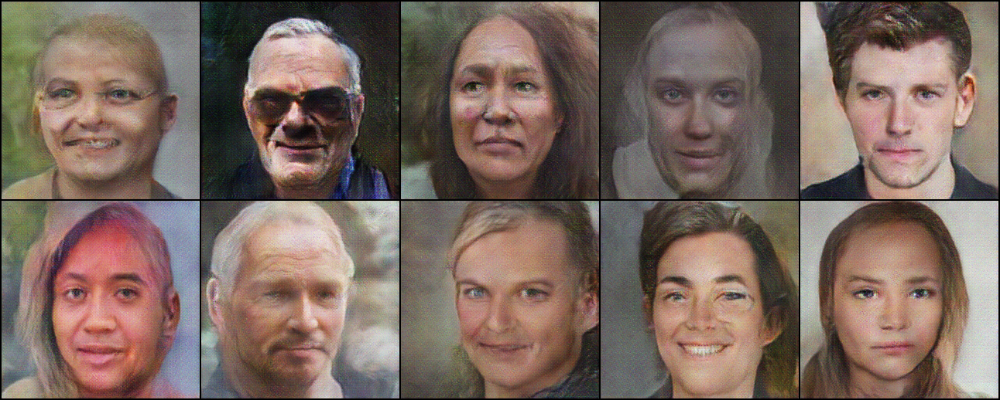

In [24]:
Image('./sample/fake_images-0300.png')

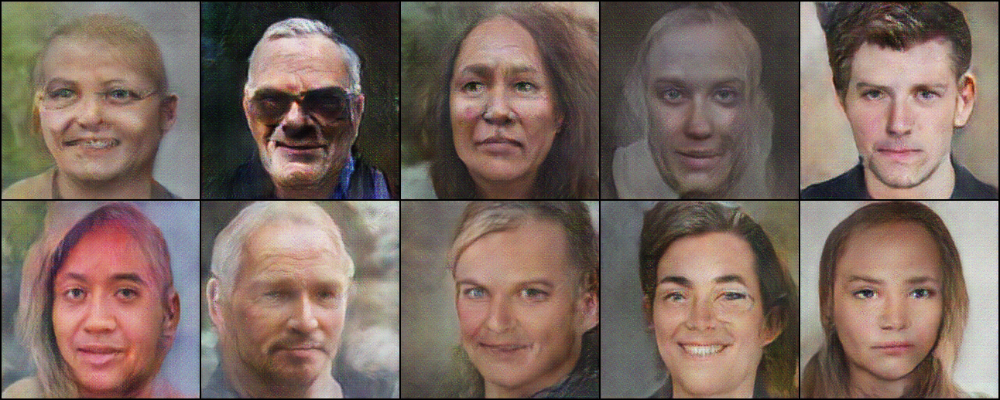

In [25]:
Image('./sample/fake_images-0400.png')

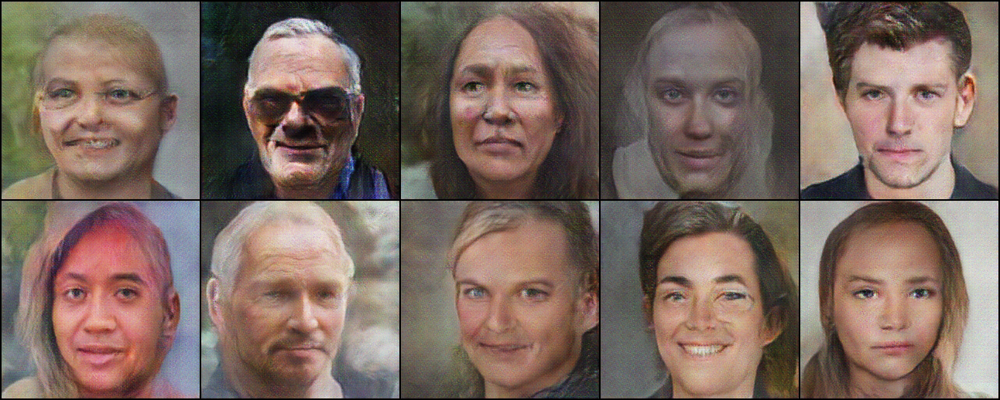

In [26]:
Image('./sample/fake_images-0500.png')

In [27]:
import cv2
import os
from IPython.display import FileLink

vid_fname = 'imgs_generation.avi'

files = [os.path.join(sample_dir, f) for f in os.listdir(sample_dir) if 'fake_images' in f]
files.sort()

out = cv2.VideoWriter(vid_fname, cv2.VideoWriter_fourcc(*'MP4V'), 8, (1292, 518))
[out.write(cv2.imread(fname)) for fname in files]
out.release()
FileLink('imgs_generation.avi')

C:\Users\Kevin\OneDrive\桌面\project\DCGAN_2\imgs_generation.avi

Text(0.5, 1.0, 'Losses')

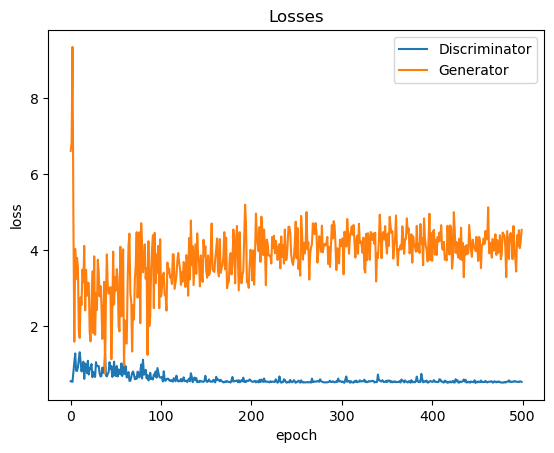

In [28]:
plt.plot(d_losses, '-')
plt.plot(g_losses, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses')

Text(0.5, 1.0, 'Scores')

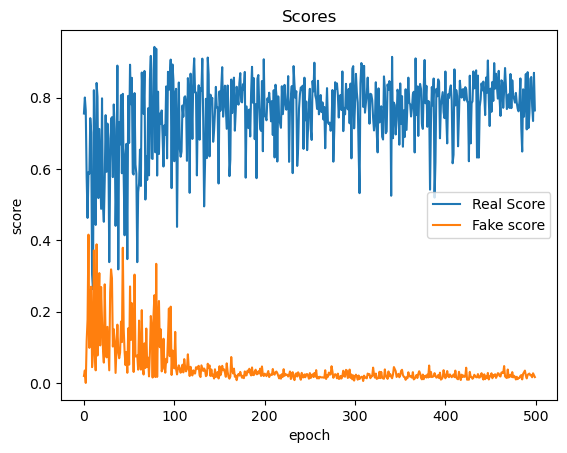

In [29]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real Score', 'Fake score'])
plt.title('Scores')

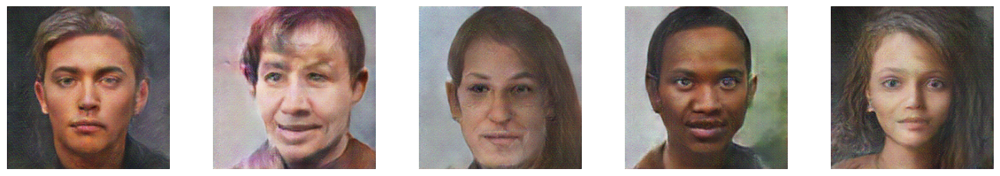

In [30]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
G.to(device)

G.load_state_dict(torch.load('./checkpoints/G.ckpt'))

latent_size = G.model[0].in_channels
sample_vectors = torch.randn(5, latent_size, 1, 1).to(device)

with torch.no_grad():
    y = G(sample_vectors)
    gen_imgs = denorm(y).cpu()

fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(15, 3))
fig.tight_layout()

for i in range(5):
    img = gen_imgs[i].permute(1, 2, 0).numpy()
    axes[i].imshow(img)
    axes[i].axis('off')

plt.show()